# Gradient Descent for Temperatures
### The following script contains the following:

#### 1. Import libraries and data
#### 2. We'll need to reduce the dataset to only one year of data.
#### 3. Reduce Data Set to 3 Different Weather Stations and Years
#### 4. 3D visualization of the temperatures over time.
#### 5. Analyze GDANSK_Temp_Mean, 2022
#### 6. Analyze DEBILT_Temp_Mean, 2021
#### 7. Analyze LJUBLJANA_Temp_Mean, 2020
---------------------------------------------------------------------------------------------------------------------------
## 1. Import libraries and data
---------------------------------------------------------------------------------------------------------------------------

In [1]:
import pandas as pd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import os
from mpl_toolkits import mplot3d

from plotly.offline import download_plotlyjs, init_notebook_mode
from plotly.offline import plot, iplot
import plotly.graph_objects as go

In [2]:
%matplotlib inline

# Turning off warning feature
import warnings
warnings.filterwarnings('ignore')

# Supress scientific notation for easier analysis profiling
pd.set_option('display.float_format', '{:.2f}'.format)

In [3]:
#Create a path to where your data is stored.
path = r"ClimateWins"

In [4]:
#Read in the European weather data.
climate = pd.read_csv(os.path.join(path, '02 Data Sets', 'Prepared Data', 'weather_data_scaled.csv'), index_col=False)
climate

,DATE,MONTH,BASEL_cloud_cover,BASEL_wind_speed,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_snow_depth,BASEL_sunshine,...,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_snow_depth,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,19600101,1,0.66,-0.03,0.83,-0.00,-1.10,-0.27,-0.18,-0.90,...,-0.44,0.76,-1.30,-0.81,-0.09,-0.02,0.37,-0.67,-0.52,-0.75
1,19600102,1,0.24,-0.03,0.74,-0.00,-1.06,1.66,-0.18,-0.81,...,0.78,1.18,-1.26,-1.04,0.50,-0.02,-0.83,-0.55,-0.63,-0.41
2,19600103,1,1.08,-0.03,1.28,-0.00,-1.25,0.16,-0.18,-1.07,...,0.78,1.18,-0.43,-1.14,-0.40,-0.02,-1.01,-0.07,0.05,-0.18
3,19600104,1,-1.00,-0.03,1.46,-0.00,-0.82,-0.45,-0.18,-0.11,...,0.78,0.48,0.39,-1.18,0.67,-0.02,-1.04,-1.00,-0.16,-0.84
4,19600105,1,0.24,-0.03,1.73,-0.00,-0.75,-0.16,-0.18,0.19,...,-1.67,-0.36,1.73,-0.79,-0.49,-0.02,0.67,-1.51,-1.34,-1.47
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,10,-1.83,-0.03,0.28,1.04,-0.01,-0.00,-0.18,0.72,...,-0.44,-0.08,-0.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.00,-0.00
22946,20221028,10,0.24,-0.03,0.10,0.98,-0.01,-0.00,-0.18,0.19,...,-0.44,-0.08,-0.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.00,-0.00
22947,20221029,10,-0.59,-0.03,0.01,0.72,-0.01,-0.00,-0.18,0.35,...,-0.44,-0.08,-0.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.00,-0.00
22948,20221030,10,-0.17,-0.03,0.37,0.49,-0.01,-0.00,-0.18,0.28,...,-0.44,-0.08,-0.00,-0.01,-0.01,-0.02,-0.02,-0.01,-0.00,-0.00


In [5]:
#Reduce to just the mean temperatures
df = climate[['DATE', 'MONTH','BASEL_temp_mean',
 'BELGRADE_temp_mean',
 'BUDAPEST_temp_mean',
 'DEBILT_temp_mean',
 'DUSSELDORF_temp_mean',
 'GDANSK_temp_mean',
 'HEATHROW_temp_mean',
 'KASSEL_temp_mean',
 'LJUBLJANA_temp_mean',
 'MAASTRICHT_temp_mean',
 'MADRID_temp_mean',
 'MUNCHENB_temp_mean',
 'OSLO_temp_mean',
 'ROMA_temp_mean',
 'SONNBLICK_temp_mean',
 'STOCKHOLM_temp_mean',
 'TOURS_temp_mean',
 'VALENTIA_temp_mean']].copy()

In [6]:
df

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
0,19600101,1,-0.53,-1.02,-1.10,-0.11,-0.11,-0.93,-0.11,-0.18,-1.37,-0.10,-0.99,-0.27,-0.19,-1.28,-0.12,-0.39,-0.26,-0.67
1,19600102,1,-0.58,-1.11,-1.11,-0.37,-0.37,-0.83,-0.89,-0.21,-1.04,-0.23,-0.69,-0.35,-0.37,-0.54,-0.65,-0.42,-0.34,-0.55
2,19600103,1,-0.26,-1.08,-1.06,-0.51,-0.53,-0.94,-0.49,-0.39,-0.74,-0.49,-0.85,-0.40,-0.55,-0.88,-0.65,-0.62,-0.21,-0.07
3,19600104,1,-0.56,-1.21,-1.15,-0.53,-0.58,-1.04,-0.32,-0.49,-0.91,-0.47,-0.62,-0.64,-0.42,-0.78,-0.94,-0.76,-0.07,-1.00
4,19600105,1,-1.00,-1.21,-1.09,-0.32,-0.44,-0.98,-0.40,-0.55,-0.86,-0.31,-0.38,-0.91,-0.33,-0.93,-0.62,-0.50,-0.04,-1.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,10,0.75,0.63,-0.01,0.90,1.04,0.44,0.91,-0.01,0.48,1.27,0.68,0.66,0.40,-0.00,0.83,0.52,1.30,-0.01
22946,20221028,10,0.86,0.37,-0.01,0.95,1.28,0.47,0.80,-0.01,0.26,1.31,0.56,0.89,0.54,-0.00,1.07,0.64,1.36,-0.01
22947,20221029,10,0.86,0.08,-0.01,0.91,1.10,0.79,0.92,-0.01,0.30,1.21,0.55,1.05,0.40,-0.00,1.22,0.72,1.41,-0.01
22948,20221030,10,0.68,0.27,-0.01,0.69,0.88,0.38,0.70,-0.01,0.40,0.92,0.10,0.69,-0.07,-0.00,1.24,0.02,0.67,-0.01


In [7]:
df.describe()

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
count,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00,22950.00
mean,19909835.76,6.51,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00
std,181383.27,3.44,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,19600101.00,1.00,-3.92,-3.40,-3.32,-3.67,-3.73,-4.07,-3.51,-3.68,-3.18,-3.76,-2.62,-3.96,-3.45,-3.54,-3.91,-3.89,-3.80,-4.27
25%,19750916.25,4.00,-0.77,-0.79,-0.81,-0.72,-0.74,-0.75,-0.77,-0.67,-0.83,-0.73,-0.84,-0.77,-0.73,-0.72,-0.69,-0.75,-0.71,-0.58
50%,19910601.50,7.00,0.04,0.08,0.01,0.03,0.03,-0.01,-0.00,-0.01,0.06,0.02,-0.13,0.05,-0.00,-0.00,0.05,-0.04,-0.01,-0.01
75%,20070214.75,9.00,0.79,0.81,0.81,0.77,0.76,0.84,0.80,0.71,0.81,0.76,0.84,0.79,0.84,0.72,0.75,0.84,0.76,0.68
max,20221031.00,12.00,2.55,2.49,2.51,3.11,3.02,2.50,3.44,2.84,2.38,3.11,2.49,2.57,2.42,2.71,2.60,2.61,3.07,3.87


---------------------------------------------------------------------------------------------------------------------------
## 2. We'll need to reduce the dataset to only one year of data.

In [8]:
df['DATE'].describe() #View statistics of all years

count      22950.00
mean    19909835.76
std       181383.27
min     19600101.00
25%     19750916.25
50%     19910601.50
75%     20070214.75
max     20221031.00
Name: DATE, dtype: float64

In [9]:
#Drop the DATE and MONTH data as those numbers are not scaled with the rest.
nodate = df.drop(['DATE','MONTH'], axis=1)
nodate

,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
0,-0.53,-1.02,-1.10,-0.11,-0.11,-0.93,-0.11,-0.18,-1.37,-0.10,-0.99,-0.27,-0.19,-1.28,-0.12,-0.39,-0.26,-0.67
1,-0.58,-1.11,-1.11,-0.37,-0.37,-0.83,-0.89,-0.21,-1.04,-0.23,-0.69,-0.35,-0.37,-0.54,-0.65,-0.42,-0.34,-0.55
2,-0.26,-1.08,-1.06,-0.51,-0.53,-0.94,-0.49,-0.39,-0.74,-0.49,-0.85,-0.40,-0.55,-0.88,-0.65,-0.62,-0.21,-0.07
3,-0.56,-1.21,-1.15,-0.53,-0.58,-1.04,-0.32,-0.49,-0.91,-0.47,-0.62,-0.64,-0.42,-0.78,-0.94,-0.76,-0.07,-1.00
4,-1.00,-1.21,-1.09,-0.32,-0.44,-0.98,-0.40,-0.55,-0.86,-0.31,-0.38,-0.91,-0.33,-0.93,-0.62,-0.50,-0.04,-1.51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,0.75,0.63,-0.01,0.90,1.04,0.44,0.91,-0.01,0.48,1.27,0.68,0.66,0.40,-0.00,0.83,0.52,1.30,-0.01
22946,0.86,0.37,-0.01,0.95,1.28,0.47,0.80,-0.01,0.26,1.31,0.56,0.89,0.54,-0.00,1.07,0.64,1.36,-0.01
22947,0.86,0.08,-0.01,0.91,1.10,0.79,0.92,-0.01,0.30,1.21,0.55,1.05,0.40,-0.00,1.22,0.72,1.41,-0.01
22948,0.68,0.27,-0.01,0.69,0.88,0.38,0.70,-0.01,0.40,0.92,0.10,0.69,-0.07,-0.00,1.24,0.02,0.67,-0.01


In [10]:
df.to_csv(os.path.join(path, '02 Data Sets', 'Supervised', 'scaled_temp_mean.csv'), index=False)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18]),
 [Text(1, 0, 'BASEL_temp_mean'),
  Text(2, 0, 'BELGRADE_temp_mean'),
  Text(3, 0, 'BUDAPEST_temp_mean'),
  Text(4, 0, 'DEBILT_temp_mean'),
  Text(5, 0, 'DUSSELDORF_temp_mean'),
  Text(6, 0, 'GDANSK_temp_mean'),
  Text(7, 0, 'HEATHROW_temp_mean'),
  Text(8, 0, 'KASSEL_temp_mean'),
  Text(9, 0, 'LJUBLJANA_temp_mean'),
  Text(10, 0, 'MAASTRICHT_temp_mean'),
  Text(11, 0, 'MADRID_temp_mean'),
  Text(12, 0, 'MUNCHENB_temp_mean'),
  Text(13, 0, 'OSLO_temp_mean'),
  Text(14, 0, 'ROMA_temp_mean'),
  Text(15, 0, 'SONNBLICK_temp_mean'),
  Text(16, 0, 'STOCKHOLM_temp_mean'),
  Text(17, 0, 'TOURS_temp_mean'),
  Text(18, 0, 'VALENTIA_temp_mean')])

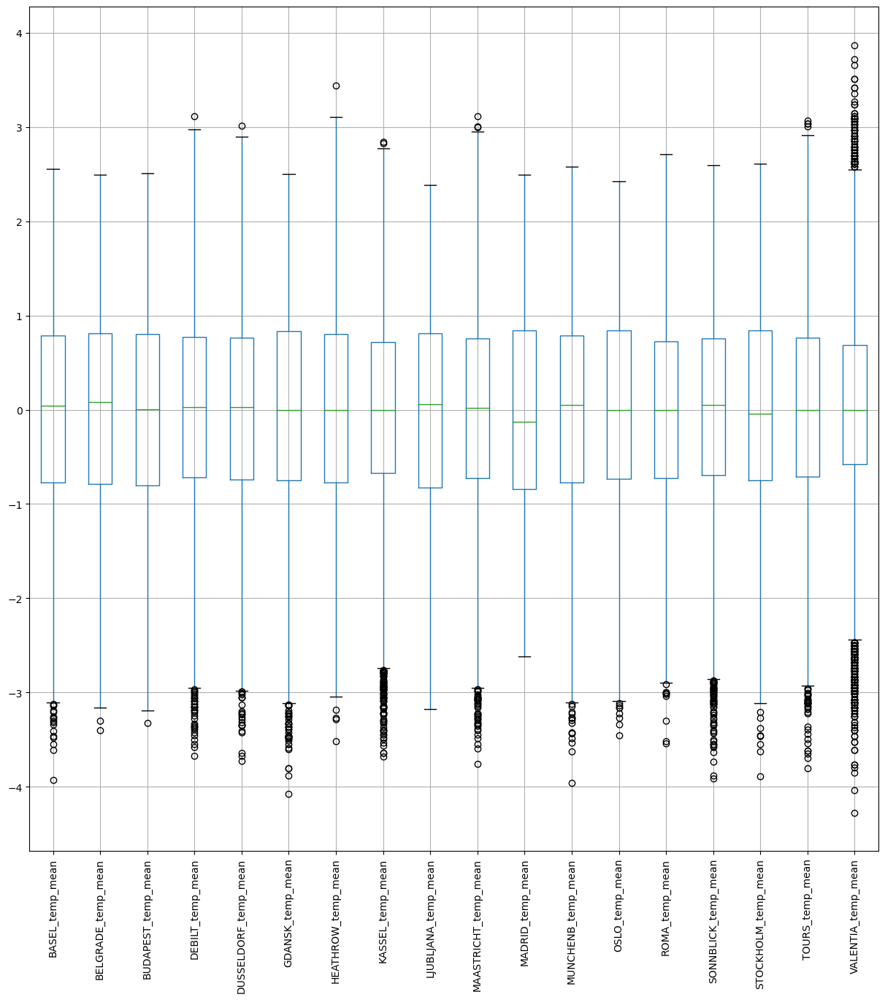

In [11]:
#Look at a whisker plot of the data to see variations in temperatures
nodate.boxplot(figsize=(15,15))
plt.xticks(rotation=90)

---------------------------------------------------------------------------------------------------------------------------
## 3. Reduce Data Set to 3 Different Weather Stations and Years

In [12]:
#reduce the dataset to a single year '2022'

# filter data for the year '2022'
#df[df['DATE'].astype(str).str.contains('2022')] #filters by all combinations
dfyear22 = df[df['DATE'].astype(str).str[:4] == '2022'] #filters by first 4 digits of #year [:4]
dfyear22

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
22646,20220101,1,-0.57,-0.30,-0.01,0.36,0.31,-0.33,0.49,-0.01,-1.04,0.32,-0.52,-0.06,-1.06,-0.00,0.53,-0.95,-0.34,-0.01
22647,20220102,1,-0.54,-0.13,-0.01,0.27,0.10,-0.16,0.03,-0.01,-1.13,0.22,-0.69,0.06,-0.74,-0.00,0.74,-0.59,-0.10,-0.01
22648,20220103,1,0.12,-0.34,-0.01,-0.05,-0.15,-0.08,-0.25,-0.01,-0.67,-0.16,-0.71,0.16,-0.65,-0.00,0.01,-0.38,0.03,-0.01
22649,20220104,1,0.16,-0.28,-0.01,-0.56,-0.58,-0.36,-0.61,-0.01,-0.15,-0.61,-0.85,0.19,-1.10,-0.00,-0.12,-0.75,-0.18,-0.01
22650,20220105,1,-0.99,0.15,-0.01,-0.78,-1.02,-0.72,-1.29,-0.01,-0.51,-1.06,-1.12,-0.89,-1.07,-0.00,-0.93,-1.13,-1.18,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,20221027,10,0.75,0.63,-0.01,0.90,1.04,0.44,0.91,-0.01,0.48,1.27,0.68,0.66,0.40,-0.00,0.83,0.52,1.30,-0.01
22946,20221028,10,0.86,0.37,-0.01,0.95,1.28,0.47,0.80,-0.01,0.26,1.31,0.56,0.89,0.54,-0.00,1.07,0.64,1.36,-0.01
22947,20221029,10,0.86,0.08,-0.01,0.91,1.10,0.79,0.92,-0.01,0.30,1.21,0.55,1.05,0.40,-0.00,1.22,0.72,1.41,-0.01
22948,20221030,10,0.68,0.27,-0.01,0.69,0.88,0.38,0.70,-0.01,0.40,0.92,0.10,0.69,-0.07,-0.00,1.24,0.02,0.67,-0.01


In [13]:
dfyear22.describe()

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
count,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00,304.00
mean,20220568.35,5.53,0.48,0.41,-0.01,0.42,0.41,0.36,0.48,-0.01,0.43,0.46,0.46,0.47,0.35,-0.00,0.39,0.35,0.58,-0.01
std,287.84,2.88,0.99,0.97,0.00,0.89,0.95,0.89,1.02,0.00,1.02,0.96,1.08,0.93,0.84,0.00,1.02,0.91,1.06,0.00
min,20220101.00,1.00,-1.78,-1.97,-0.01,-1.32,-1.42,-1.48,-1.75,-0.01,-1.77,-1.49,-1.50,-1.45,-1.51,-0.00,-2.00,-1.66,-2.14,-0.01
25%,20220317.75,3.00,-0.20,-0.34,-0.01,-0.28,-0.30,-0.42,-0.34,-0.01,-0.44,-0.22,-0.56,-0.25,-0.41,-0.00,-0.36,-0.48,-0.23,-0.01
50%,20220601.50,6.00,0.58,0.53,-0.01,0.42,0.42,0.40,0.50,-0.01,0.43,0.46,0.57,0.56,0.44,-0.00,0.53,0.42,0.64,-0.01
75%,20220816.25,8.00,1.29,1.21,-0.01,1.12,1.18,1.01,1.20,-0.01,1.34,1.22,1.28,1.23,1.03,-0.00,1.22,1.08,1.43,-0.01
max,20221031.00,10.00,2.49,2.14,-0.01,2.67,2.63,2.40,3.44,-0.01,2.38,2.99,2.49,2.41,1.96,-0.00,2.22,2.25,2.68,-0.01


- NOTE: Highest weather station temp mean, 2020: **HEATHROW_Temp_Mean**
---------------------------------------------------------------------------------------------------------------------------

In [14]:
#reduce the dataset to a single year '2021'

# filter data for the year '2021'
#df[df['DATE'].astype(str).str.contains('2021')] #filters by all combinations
dfyear21 = df[df['DATE'].astype(str).str[:4] == '2021'] #filters by first 4 digits of #year [:4]
dfyear21

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
22281,20210101,1,-1.11,-0.65,-0.01,-1.11,-1.24,-1.27,-1.71,-0.01,-1.00,-1.22,-1.47,-1.11,-0.74,-0.00,-1.21,-0.54,-1.50,-0.01
22282,20210102,1,-1.22,-0.55,-0.01,-1.02,-1.20,-1.08,-1.50,-0.01,-0.74,-1.28,-1.72,-1.27,-0.67,-0.00,-0.88,-0.70,-1.76,-0.01
22283,20210103,1,-1.38,-0.42,-0.01,-1.06,-1.14,-1.04,-1.38,-0.01,-0.86,-1.21,-1.61,-1.21,-0.95,-0.00,-1.02,-0.94,-1.47,-0.01
22284,20210104,1,-1.33,-0.52,-0.01,-1.14,-1.27,-0.94,-1.26,-0.01,-0.89,-1.30,-1.65,-1.25,-1.15,-0.00,-1.19,-0.86,-1.58,-0.01
22285,20210105,1,-1.38,-0.70,-0.01,-1.13,-1.24,-0.80,-1.40,-0.01,-0.87,-1.27,-1.81,-1.30,-1.58,-0.00,-1.38,-0.98,-1.50,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22641,20211227,12,-0.52,-1.28,-0.01,-0.70,-0.62,-2.18,-0.47,-0.01,-0.91,-0.29,-0.37,-0.55,-1.81,-0.00,-0.61,-1.40,-0.04,-0.01
22642,20211228,12,-0.01,-1.13,-0.01,-0.19,-0.30,-1.93,-0.21,-0.01,-0.60,-0.14,-0.48,-0.33,-1.39,-0.00,-0.39,-0.93,0.03,-0.01
22643,20211229,12,-0.11,-0.85,-0.01,-0.08,-0.15,-1.29,-0.00,-0.01,-0.97,-0.05,-0.69,-0.11,-1.50,-0.00,-0.48,-0.83,0.13,-0.01
22644,20211230,12,0.35,-0.85,-0.01,0.46,0.42,-0.88,0.21,-0.01,-0.91,0.50,-0.69,0.40,-0.85,-0.00,0.05,-0.58,0.31,-0.01


In [15]:
dfyear21.describe()

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
count,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00,365.00
mean,20210668.32,6.53,0.03,0.13,-0.01,0.07,0.01,0.09,0.09,-0.01,0.10,0.06,0.09,0.09,0.10,-0.00,0.05,0.10,0.12,-0.01
std,345.48,3.45,0.95,1.01,0.00,0.97,0.98,1.07,1.01,0.00,1.01,0.96,1.01,0.93,1.06,0.00,1.03,1.05,0.99,0.00
min,20210101.00,1.00,-2.21,-2.05,-0.01,-2.50,-2.67,-2.99,-2.19,-0.01,-1.86,-2.57,-2.47,-2.13,-2.15,-0.00,-2.82,-2.29,-2.28,-0.01
25%,20210402.00,4.00,-0.75,-0.63,-0.01,-0.68,-0.68,-0.75,-0.68,-0.01,-0.70,-0.67,-0.66,-0.67,-0.57,-0.00,-0.64,-0.58,-0.65,-0.01
50%,20210702.00,7.00,-0.01,-0.04,-0.01,0.04,-0.06,-0.01,-0.00,-0.01,-0.09,-0.02,-0.09,0.04,0.07,-0.00,0.04,0.02,0.06,-0.01
75%,20211001.00,10.00,0.88,0.94,-0.01,0.99,0.88,1.03,0.99,-0.01,0.94,0.92,0.82,0.87,1.06,-0.00,0.86,0.94,0.97,-0.01
max,20211231.00,12.00,2.08,2.26,-0.01,2.21,2.56,2.32,2.39,-0.01,2.09,2.42,2.49,2.11,2.08,-0.00,2.22,2.36,2.11,-0.01


- NOTE: Highest weather station temp mean, 2020: **DUSSELDORF_Temp_Mean**
---------------------------------------------------------------------------------------------------------------------------

In [16]:
#reduce the dataset to a single year '2020'

# filter data for the year '2020'
#df[df['DATE'].astype(str).str.contains('2020')] #filters by all combinations
dfyear20 = df[df['DATE'].astype(str).str[:4] == '2020'] #filters by first 4 digits of #year [:4]
dfyear20

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
21915,20200101,1,-1.47,-1.21,-0.93,-1.46,-1.39,-0.74,-1.10,-0.01,-1.37,-1.61,-1.12,-1.03,-0.55,-0.00,-0.15,-0.48,-0.87,-0.01
21916,20200102,1,-1.40,-1.14,-1.17,-0.97,-1.23,-0.95,-0.60,-0.01,-1.63,-1.00,-1.20,-1.32,-0.28,-0.00,-0.05,-0.19,-0.41,-0.01
21917,20200103,1,-0.69,-1.36,-1.57,-0.38,-0.44,-0.80,-0.39,-0.01,-1.42,-0.40,-1.50,-0.69,-0.24,-0.00,0.01,-0.24,-0.29,-0.01
21918,20200104,1,-0.60,-1.50,-1.06,-0.53,-0.83,-0.56,-0.98,-0.01,-1.10,-0.77,-1.07,-0.59,-0.70,-0.00,-0.69,-0.62,-0.98,-0.01
21919,20200105,1,-1.18,-1.05,-1.04,-0.49,-0.64,-0.72,-0.65,-0.01,-1.23,-0.64,-1.18,-0.82,-0.79,-0.00,-1.38,-0.90,-0.82,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22276,20201227,12,-1.18,-1.13,-1.37,-0.79,-0.87,-1.02,-0.88,-0.01,-1.38,-0.88,-1.64,-1.40,-0.43,-0.00,-1.15,-0.39,-0.95,-0.01
22277,20201228,12,-0.79,-0.53,-0.86,-1.02,-0.95,-0.71,-1.78,-0.01,-1.26,-1.09,-1.24,-1.10,-0.62,-0.00,-1.18,-0.39,-1.14,-0.01
22278,20201229,12,-0.81,-0.13,-0.35,-1.00,-1.36,-0.48,-1.54,-0.01,-0.95,-1.21,-1.41,-0.78,-0.50,-0.00,-1.24,-0.37,-1.04,-0.01
22279,20201230,12,-1.06,-0.05,-0.50,-0.92,-1.05,-0.84,-1.52,-0.01,-0.93,-1.01,-1.37,-0.86,-0.57,-0.00,-1.28,-0.57,-1.12,-0.01


In [17]:
dfyear20.describe()

,DATE,MONTH,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
count,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00,366.00
mean,20200667.12,6.51,0.24,0.19,0.17,0.26,0.23,0.25,0.24,-0.01,0.17,0.28,0.15,0.25,0.28,-0.00,0.26,0.30,0.32,-0.01
std,345.77,3.46,0.93,0.92,0.92,0.88,0.91,0.82,0.97,0.00,0.92,0.91,1.00,0.88,0.78,0.00,0.89,0.79,0.92,0.00
min,20200101.00,1.00,-1.68,-1.63,-1.58,-1.49,-1.61,-1.34,-2.12,-0.01,-1.63,-1.73,-1.64,-1.43,-1.29,-0.00,-2.11,-1.08,-1.54,-0.01
25%,20200401.25,4.00,-0.55,-0.56,-0.59,-0.43,-0.50,-0.43,-0.51,-0.01,-0.64,-0.43,-0.64,-0.48,-0.36,-0.00,-0.29,-0.33,-0.41,-0.01
50%,20200701.50,7.00,0.24,0.24,0.18,0.23,0.17,0.14,0.10,-0.01,0.21,0.23,-0.09,0.29,0.11,-0.00,0.25,0.11,0.32,-0.01
75%,20200983.25,9.75,0.98,0.99,0.95,0.90,0.85,0.95,1.03,-0.01,0.92,0.95,1.00,0.95,0.87,-0.00,0.91,0.95,0.97,-0.01
max,20201231.00,12.00,2.31,1.95,1.94,2.69,2.50,2.04,3.04,-0.01,1.93,2.78,2.33,2.15,2.20,-0.00,2.23,2.16,2.66,-0.01


- NOTE: Highest weather station temp mean, 2020: **HEATHROW_Temp_Mean**

---------------------------------------------------------------------------------------------------------------------------
## 4. Below is a 3D visualization of the temperatures over time.

In [18]:
#drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempdate = dfyear22.drop(['DATE','MONTH'], axis=1)
notempdate

,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
22646,-0.57,-0.30,-0.01,0.36,0.31,-0.33,0.49,-0.01,-1.04,0.32,-0.52,-0.06,-1.06,-0.00,0.53,-0.95,-0.34,-0.01
22647,-0.54,-0.13,-0.01,0.27,0.10,-0.16,0.03,-0.01,-1.13,0.22,-0.69,0.06,-0.74,-0.00,0.74,-0.59,-0.10,-0.01
22648,0.12,-0.34,-0.01,-0.05,-0.15,-0.08,-0.25,-0.01,-0.67,-0.16,-0.71,0.16,-0.65,-0.00,0.01,-0.38,0.03,-0.01
22649,0.16,-0.28,-0.01,-0.56,-0.58,-0.36,-0.61,-0.01,-0.15,-0.61,-0.85,0.19,-1.10,-0.00,-0.12,-0.75,-0.18,-0.01
22650,-0.99,0.15,-0.01,-0.78,-1.02,-0.72,-1.29,-0.01,-0.51,-1.06,-1.12,-0.89,-1.07,-0.00,-0.93,-1.13,-1.18,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,0.75,0.63,-0.01,0.90,1.04,0.44,0.91,-0.01,0.48,1.27,0.68,0.66,0.40,-0.00,0.83,0.52,1.30,-0.01
22946,0.86,0.37,-0.01,0.95,1.28,0.47,0.80,-0.01,0.26,1.31,0.56,0.89,0.54,-0.00,1.07,0.64,1.36,-0.01
22947,0.86,0.08,-0.01,0.91,1.10,0.79,0.92,-0.01,0.30,1.21,0.55,1.05,0.40,-0.00,1.22,0.72,1.41,-0.01
22948,0.68,0.27,-0.01,0.69,0.88,0.38,0.70,-0.01,0.40,0.92,0.10,0.69,-0.07,-0.00,1.24,0.02,0.67,-0.01


In [19]:
#plot ALL weather data for all stations (over time)

#X = weather stations
#Y = day of the year
#Z = temperature

#click/hold in the graph below to rotate!

fig = go.Figure(data=[go.Surface(z=nodate.values)])
fig.update_layout(title='All weather temperatures over time', autosize=False,
                  width=600, height=600)

In [20]:
#plot ALL weather data for all stations (for a year)

#X = weather stations
#Y = day of the year
#Z = temperature

#click/hold in the graph below to rotate!

fig = go.Figure(data=[go.Surface(z=notempdate.values)])
fig.update_layout(title='GDANSK weather temperatures over 2022', autosize=False,
                  width=600, height=600)

In [21]:
n_rows = dfyear22.shape[0]
n_rows

304

In [22]:
#we need to make an index for the year. 
#creating a set of data from 1 to 304 instead of 365, as the dataset only contains 304 rows (or days)
#we'll scale this by 100 as the index is made.

i = np.arange(0.01,3.05,0.01) #<---needs to be one GREATER than the total number of days
index = pd.DataFrame(data = i, columns = ['index'])
index

,index
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
299,3.00
300,3.01
301,3.02
302,3.03


In [23]:
#this will translate our chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)

In [24]:
#represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear22['GDANSK_temp_mean'].to_numpy().reshape(n_rows,1) #<----chosen as it has the highest recorded mean temps from our 3D plot

In [25]:
X.shape, y.shape

((304, 2), (304, 1))

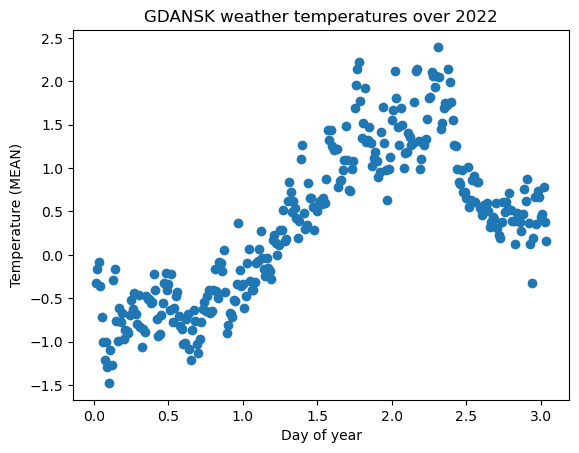

In [26]:
#look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear22['GDANSK_temp_mean'])
plt.xlabel('Day of year'); plt.ylabel('Temperature (MEAN)');
plt.title('GDANSK weather temperatures over 2022');

In [27]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear22['GDANSK_temp_mean'].min()

-1.4775001226225373

In [28]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear22['GDANSK_temp_mean'].max()

2.3973711693962154

---------------------------------------------------------------------------------------------------------------------------
## 5. Analyze GDANSK_Temp_Mean, 2022

In [29]:
#this computes the loss function for the gradiant descent.

def compute_cost(X, y, theta=np.array([[0],[0]])):
    """Given covariate matrix X, the prediction results y and coefficients theta
    compute the loss"""
    
    m = len(y)
    J=0 # initialize loss to zero
    
    # reshape theta
    theta=theta.reshape(2,1)
    
    # calculate the hypothesis - y_hat
    h_x = np.dot(X,theta)
    #print(h_x)
    
    # subtract y from y_hat, square and sum
    error_term = sum((h_x - y)**2)
    
    # divide by twice the number of samples - standard practice.
    loss = error_term/(2*m)
    
    return loss

In [30]:
compute_cost(X,y)

array([0.45942842])

In [31]:
#this is the gradiant descent function.

def gradient_descent(X, y, theta=np.array([[0],[0]]),
                    alpha=0.01, num_iterations=1500):
    """
    Solve for theta using Gradient Descent optimization technique. 
    Alpha is the learning rate
    """
    m = len(y)
    J_history = []
    theta0_history = []
    theta1_history = []
    theta = theta.reshape(2,1)
    
    for i in range(num_iterations):
        error = (np.dot(X, theta) - y)
        
        term0 = (alpha/m) * sum(error* X[:,0].reshape(m,1))
        term1 = (alpha/m) * sum(error* X[:,1].reshape(m,1))
        
        # update theta
        term_vector = np.array([[term0],[term1]])
        #print(term_vector)
        theta = theta - term_vector.reshape(2,1)
        
        # store history values
        theta0_history.append(theta[0].tolist()[0])
        theta1_history.append(theta[1].tolist()[0])
        J_history.append(compute_cost(X,y,theta).tolist()[0])
        
    return (theta, J_history, theta0_history, theta1_history)

In [32]:
%%time
#this runs oour data through a gradiant descent for the starting conditions in 'theta_init.'
#adjust these numbers

num_iterations=50 #<---How many iterations needed. Start small and work up.
theta_init=np.array([[-10],[-5]]) #<---guess for [theta0], [theta1].
alpha=0.1 #<---Decide step size. Adjust iterations.
#If solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 0 ns
Wall time: 24.2 ms


In [33]:
theta

array([[-2.54389293],
       [ 1.66992083]])

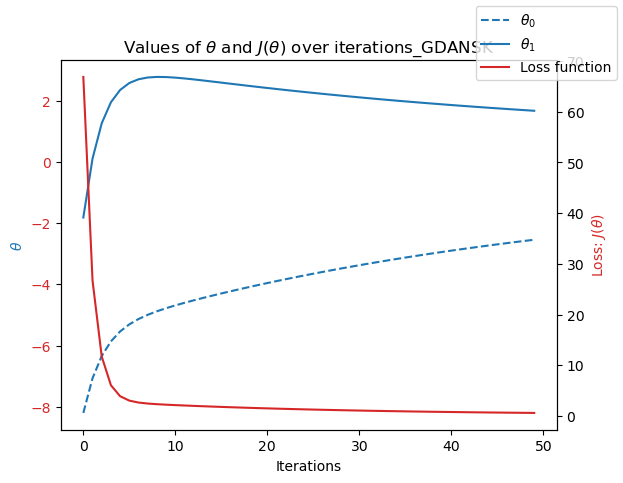

In [34]:
#this will plot our loss, theta0, and theta1. If the result looks like a straight line, it's not converging on an answer!
#the loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations_GDANSK')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();

**note:** The loss function seems to be converging toward the minimum, and the thetas also seem to be showing minimal loss, starting with initial guesses than correcting itself into stabilization of low losses.

In [35]:
# find the minimum and maximum values of theta0 and theta1
theta0_min = min(theta0_history)
theta0_max = max(theta0_history)
theta1_min = min(theta1_history)
theta1_max = max(theta1_history)

print("Limits for theta0: ", theta0_min, "to", theta0_max)
print("Limits for theta1: ", theta1_min, "to", theta1_max)

Limits for theta0:  -8.201560449732625 to -2.5438929299568573
Limits for theta1:  -1.8168699954232945 to 2.7754596135434184


In [36]:
%%time
# theta range
theta0_vals = np.linspace(-10,10,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-10,10,100) #Put those values as the first two "linspace" numbers in these lines
                                      
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 516 ms
Wall time: 2.98 s


In [37]:
#this figure shows the loss function.

#X = Theta0
#Y - Theta1
#Z = Loss
#Find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

fig = go.Figure(data=[go.Surface(x=theta1_vals, y=theta0_vals, z=J_vals)])
fig.update_layout(title='Loss function for different thetas_GDANSK', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

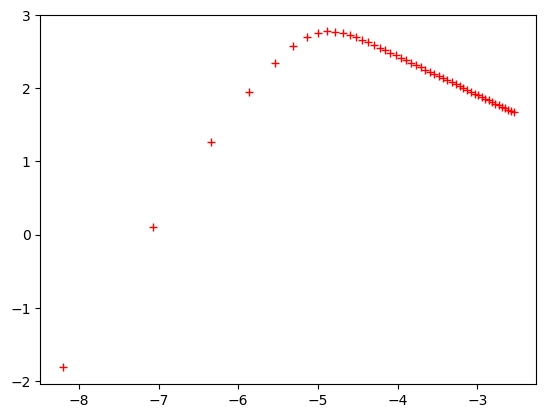

In [38]:
#here is the same figure as above, with the line the loss function takes toward the minimum.

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas_GDANSK', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

In [39]:
#rerun the optimization above, but this time start closer to the objective!
#find where the black line ends near the lowest X/Y/Z coordinate and make that our guess below.

num_iterations=50 #<---start with the same iterations as above
theta_init=np.array([[2],[-3]]) #<---guess [x],[y] coordinates near the minimum in the graph above.
alpha= 0.1 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

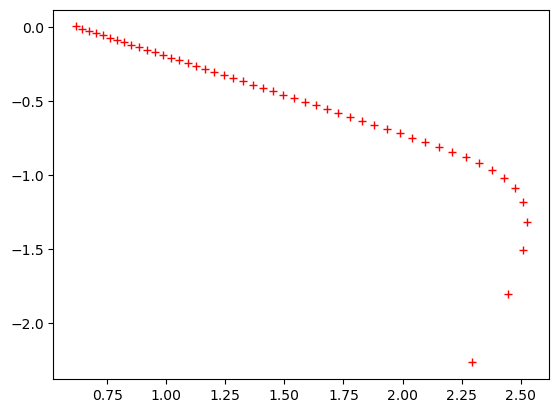

In [40]:
#let's look at the new loss path on the function, it should start much closer to the goal

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas_GDANSK', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

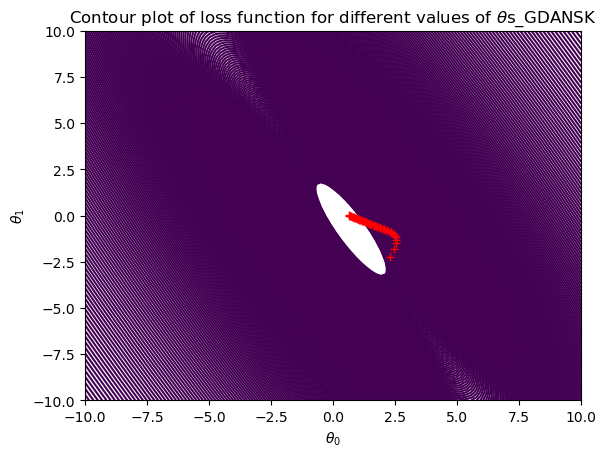

In [41]:
#shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,1000))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s_GDANSK");
plt.plot(theta0_history1, theta1_history1, 'r+');

### How well does gradient descent converge? 
- The convergence of the gradient descent algorithm appears to be relatively effective. The final point in the black line path of the gradient descent is close to the minimum to reach, which is **(x=0.7070707, y=-0.7070707, z=0.1953764).**

- Although the final point **(x=0.06415283, y=0.6175207, z=0.4271921)** is not an exact match to the minimum, it shows that the algorithm is moving in the right direction and is converging towards the minimum.

- This suggests that the gradient descent is performing reasonably well in this context.

### How much do you need to adjust between different weather stations and years
- Not much, may need to increase the number of iterations as we didnt fully reach the minimum
---------------------------------------------------------------------------------------------------------------------------

---------------------------------------------------------------------------------------------------------------------------
## 6. Analyze DUSSELDORF_Temp_Mean, 2021

In [42]:
#drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempdate1 = dfyear21.drop(['DATE','MONTH'], axis=1)
notempdate1

,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
22281,-1.11,-0.65,-0.01,-1.11,-1.24,-1.27,-1.71,-0.01,-1.00,-1.22,-1.47,-1.11,-0.74,-0.00,-1.21,-0.54,-1.50,-0.01
22282,-1.22,-0.55,-0.01,-1.02,-1.20,-1.08,-1.50,-0.01,-0.74,-1.28,-1.72,-1.27,-0.67,-0.00,-0.88,-0.70,-1.76,-0.01
22283,-1.38,-0.42,-0.01,-1.06,-1.14,-1.04,-1.38,-0.01,-0.86,-1.21,-1.61,-1.21,-0.95,-0.00,-1.02,-0.94,-1.47,-0.01
22284,-1.33,-0.52,-0.01,-1.14,-1.27,-0.94,-1.26,-0.01,-0.89,-1.30,-1.65,-1.25,-1.15,-0.00,-1.19,-0.86,-1.58,-0.01
22285,-1.38,-0.70,-0.01,-1.13,-1.24,-0.80,-1.40,-0.01,-0.87,-1.27,-1.81,-1.30,-1.58,-0.00,-1.38,-0.98,-1.50,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22641,-0.52,-1.28,-0.01,-0.70,-0.62,-2.18,-0.47,-0.01,-0.91,-0.29,-0.37,-0.55,-1.81,-0.00,-0.61,-1.40,-0.04,-0.01
22642,-0.01,-1.13,-0.01,-0.19,-0.30,-1.93,-0.21,-0.01,-0.60,-0.14,-0.48,-0.33,-1.39,-0.00,-0.39,-0.93,0.03,-0.01
22643,-0.11,-0.85,-0.01,-0.08,-0.15,-1.29,-0.00,-0.01,-0.97,-0.05,-0.69,-0.11,-1.50,-0.00,-0.48,-0.83,0.13,-0.01
22644,0.35,-0.85,-0.01,0.46,0.42,-0.88,0.21,-0.01,-0.91,0.50,-0.69,0.40,-0.85,-0.00,0.05,-0.58,0.31,-0.01


In [43]:
#plot ALL weather data for all stations for a year 

#X = weather station
#Y = day of the year
#Z = temperature

#click/hold in the graph below to rotate!

fig1 = go.Figure(data=[go.Surface(z=notempdate1.values)])
fig1.update_layout(title='DEBILT weather temperatures over 2021', autosize=False,
                  width=600, height=600)

In [44]:
n_rows1 = dfyear21.shape[0]
n_rows1

365

In [45]:
#make an index for the year. 
#create a set of data from 1 to 365 (days)
#scale it by 100 as the index is made.

i = np.arange(0.01,3.66,0.01) #<---one GREATER than the total number of days
index1 = pd.DataFrame(data = i, columns = ['index1'])
index1

,index1
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
360,3.61
361,3.62
362,3.63
363,3.64


In [46]:
#this will translate our chosen weather data into the X and y datasets needed for the optimization function.

X=index1.to_numpy().reshape(n_rows1,1)

In [47]:
#represent x_0 as a vector of 1s for vector computation
ones1 = np.ones((n_rows1,1))
X = np.concatenate((ones1, X), axis=1)
y=dfyear21['DEBILT_temp_mean'].to_numpy().reshape(n_rows1,1) #<----highest temp mean from our 3D plot

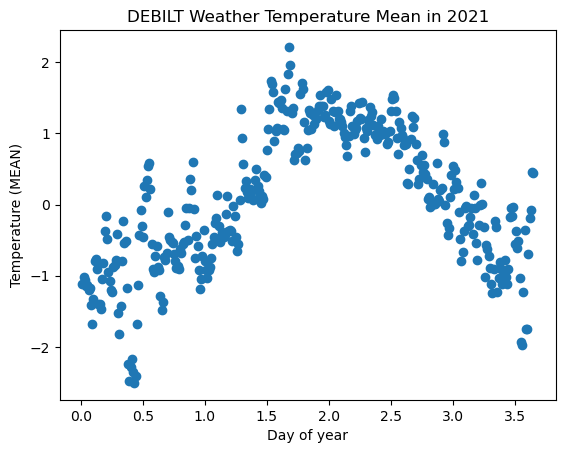

In [48]:
#look at one year of temperature data over time
plt.scatter(x=index1['index1'], y=dfyear21['DEBILT_temp_mean'])
plt.xlabel('Day of year'); plt.ylabel('Temperature (MEAN)');
plt.title('DEBILT Weather Temperature Mean in 2021');

In [49]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear21['DEBILT_temp_mean'].min()

-2.503512732997806

In [50]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear21['DEBILT_temp_mean'].max()

2.2115122447500486

In [51]:
num_iterations=100 #<---use same iterations
theta_init=np.array([[2],[-3]]) #<---make a guess [x],[y]
alpha= 0.1 #<---use the same step size
theta2, J_history2, theta0_history2, theta1_history2 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

In [52]:
theta2

array([[-0.04064544],
       [ 0.1058524 ]])

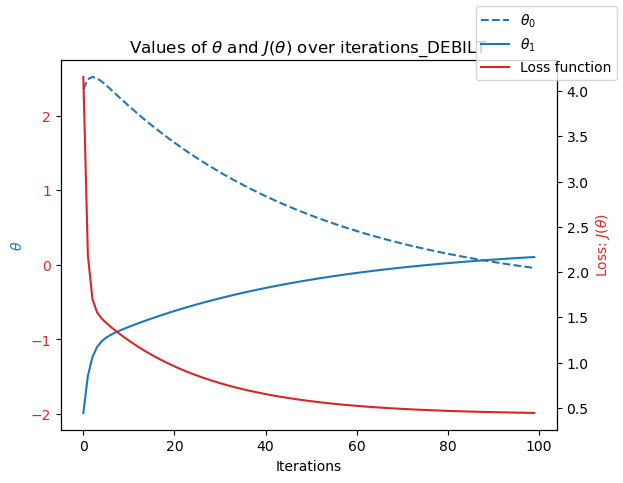

In [53]:
#this will plot the loss, theta0, and theta1.

fig1, ax2 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax2.plot(theta0_history2, label='$\\theta_{0}$', linestyle='--', color=color)
ax2.plot(theta1_history2, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax2.set_xlabel('Iterations'); ax2.set_ylabel('$\\theta$', color=color);
ax2.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax3 = ax2.twinx()
ax3.plot(J_history2, label='Loss function', color=color)
ax3.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations_DEBILT')
ax3.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig1.legend();

**note:** The loss function seems to be effectively converging toward the minimum, and the thetas also seem to be showing minimal loss, starting with initial guesses than correcting itself into stabilization of low losses.

In [54]:
#this figure shows the loss function.

#X = Theta0
#Y - Theta1
#Z = Loss
#find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

fig1 = go.Figure(data=[go.Surface(x=theta1_vals, y=theta0_vals, z=J_vals)])
fig1.update_layout(title='Loss function for different thetas_DEBILT', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

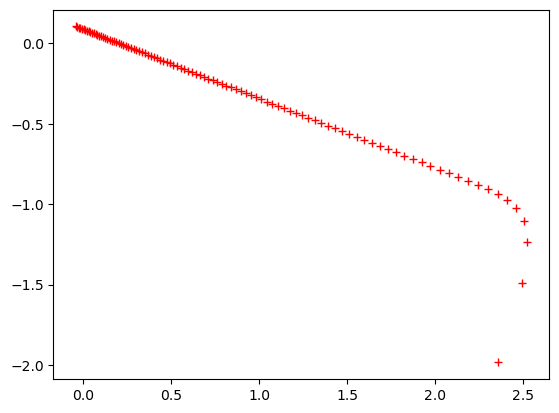

In [55]:
#here is the same figure as above, with the line the loss function takes toward the minimum.

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig1 = go.Figure()
fig1.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig1.add_scatter3d(x=theta1_history2, y=theta0_history2, z=J_history2, line=line_marker, name='')
#the below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history2, theta1_history2, 'r+');
fig1.update_layout(title='Loss function for different thetas_DEBILT', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

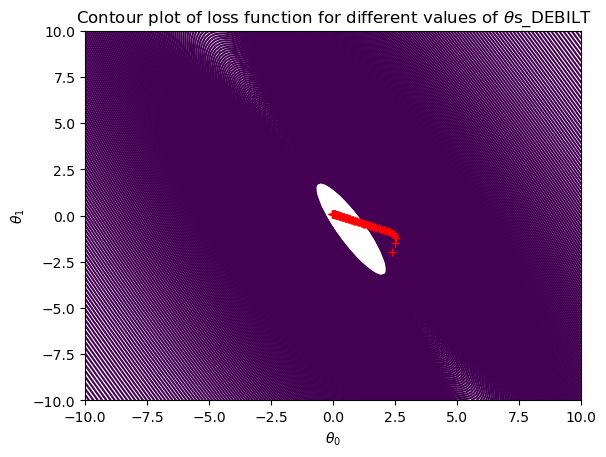

In [56]:
#plot shows the convergence

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,1000))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s_DEBILT");
plt.plot(theta0_history2, theta1_history2, 'r+');

### How well does gradient descent converge? 
- As noted, the convergence of the gradient descent algorithm appears to be relatively effective.
---------------------------------------------------------------------------------------------------------------------------

---------------------------------------------------------------------------------------------------------------------------
## 7. Analyze _Temp_Mean, 2020

In [57]:
#drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempdate2 = dfyear20.drop(['DATE','MONTH'], axis=1)
notempdate2

,BASEL_temp_mean,BELGRADE_temp_mean,BUDAPEST_temp_mean,DEBILT_temp_mean,DUSSELDORF_temp_mean,GDANSK_temp_mean,HEATHROW_temp_mean,KASSEL_temp_mean,LJUBLJANA_temp_mean,MAASTRICHT_temp_mean,MADRID_temp_mean,MUNCHENB_temp_mean,OSLO_temp_mean,ROMA_temp_mean,SONNBLICK_temp_mean,STOCKHOLM_temp_mean,TOURS_temp_mean,VALENTIA_temp_mean
21915,-1.47,-1.21,-0.93,-1.46,-1.39,-0.74,-1.10,-0.01,-1.37,-1.61,-1.12,-1.03,-0.55,-0.00,-0.15,-0.48,-0.87,-0.01
21916,-1.40,-1.14,-1.17,-0.97,-1.23,-0.95,-0.60,-0.01,-1.63,-1.00,-1.20,-1.32,-0.28,-0.00,-0.05,-0.19,-0.41,-0.01
21917,-0.69,-1.36,-1.57,-0.38,-0.44,-0.80,-0.39,-0.01,-1.42,-0.40,-1.50,-0.69,-0.24,-0.00,0.01,-0.24,-0.29,-0.01
21918,-0.60,-1.50,-1.06,-0.53,-0.83,-0.56,-0.98,-0.01,-1.10,-0.77,-1.07,-0.59,-0.70,-0.00,-0.69,-0.62,-0.98,-0.01
21919,-1.18,-1.05,-1.04,-0.49,-0.64,-0.72,-0.65,-0.01,-1.23,-0.64,-1.18,-0.82,-0.79,-0.00,-1.38,-0.90,-0.82,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22276,-1.18,-1.13,-1.37,-0.79,-0.87,-1.02,-0.88,-0.01,-1.38,-0.88,-1.64,-1.40,-0.43,-0.00,-1.15,-0.39,-0.95,-0.01
22277,-0.79,-0.53,-0.86,-1.02,-0.95,-0.71,-1.78,-0.01,-1.26,-1.09,-1.24,-1.10,-0.62,-0.00,-1.18,-0.39,-1.14,-0.01
22278,-0.81,-0.13,-0.35,-1.00,-1.36,-0.48,-1.54,-0.01,-0.95,-1.21,-1.41,-0.78,-0.50,-0.00,-1.24,-0.37,-1.04,-0.01
22279,-1.06,-0.05,-0.50,-0.92,-1.05,-0.84,-1.52,-0.01,-0.93,-1.01,-1.37,-0.86,-0.57,-0.00,-1.28,-0.57,-1.12,-0.01


In [58]:
#plot ALL weather data for all stations for a year 

#X = weather station
#Y = day of the year
#Z = temperature

#click/hold in the graph below to rotate!

fig2 = go.Figure(data=[go.Surface(z=notempdate2.values)])
fig2.update_layout(title='LJUBLJANA weather temperatures over 2020', autosize=False,
                  width=600, height=600)

In [59]:
n_rows2 = dfyear20.shape[0]
n_rows2

366

In [60]:
#make an index for the year. 
#create a set of data from 1 to 365 (days)
#scale it by 100 as the index is made.

i = np.arange(0.01,3.67,0.01) #<---one GREATER than the total number of days #LEAP YEAR
index2 = pd.DataFrame(data = i, columns = ['index2'])
index2

,index2
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
361,3.62
362,3.63
363,3.64
364,3.65


In [61]:
#this will translate our chosen weather data into the X and y datasets needed for the optimization function.

X=index2.to_numpy().reshape(n_rows2,1)

In [62]:
#represent x_0 as a vector of 1s for vector computation
ones2 = np.ones((n_rows2,1))
X = np.concatenate((ones2, X), axis=1)
y=dfyear20['LJUBLJANA_temp_mean'].to_numpy().reshape(n_rows2,1) #<----randomly chosen weather station

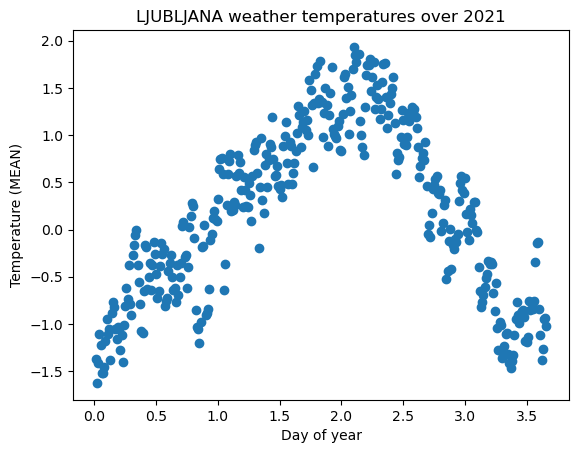

In [63]:
#look at one year of temperature data over time
plt.scatter(x=index2['index2'], y=dfyear20['LJUBLJANA_temp_mean'])
plt.xlabel('Day of year'); plt.ylabel('Temperature (MEAN)');
plt.title('LJUBLJANA weather temperatures over 2021');

In [64]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear20['LJUBLJANA_temp_mean'].min()

-1.625113133193351

In [65]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear20['LJUBLJANA_temp_mean'].max()

1.93493371135419

In [66]:
num_iterations=200 #<---use same iterations
theta_init=np.array([[2],[-3]]) #<---make a guess [x],[y]
alpha= 0.1 #<---use the same step size
theta3, J_history3, theta0_history3, theta1_history3 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

In [67]:
theta3

array([[0.02082991],
       [0.08611357]])

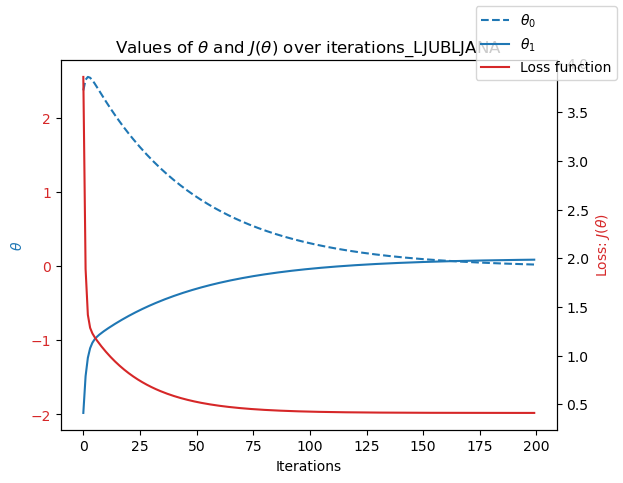

In [68]:
#This will plot the loss, theta0, and theta1.

fig2, ax3 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax3.plot(theta0_history3, label='$\\theta_{0}$', linestyle='--', color=color)
ax3.plot(theta1_history3, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax3.set_xlabel('Iterations'); ax3.set_ylabel('$\\theta$', color=color);
ax3.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax4 = ax3.twinx()
ax4.plot(J_history3, label='Loss function', color=color)
ax4.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations_LJUBLJANA')
ax4.set_ylabel('Loss: $J(\\theta)$', color=color)
ax3.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig2.legend();

In [69]:
#this figure shows the loss function.

#X = Theta0
#Y - Theta1
#Z = Loss
#find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

fig2 = go.Figure(data=[go.Surface(x=theta1_vals, y=theta0_vals, z=J_vals)])
fig2.update_layout(title='Loss function for different thetas_LJUBLJANA', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

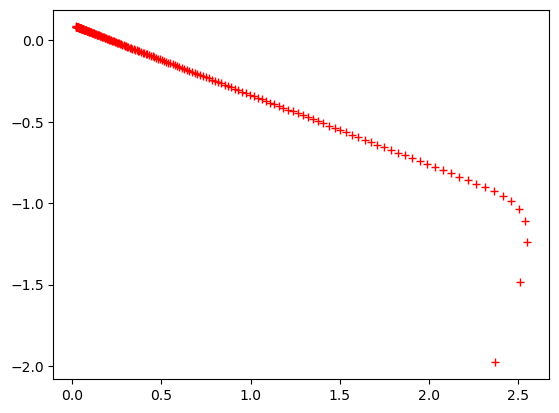

In [70]:
#line the loss function takes toward the minimum.

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#find where it is closest to 0 in X and Y!

#click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig2 = go.Figure()
fig2.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig2.add_scatter3d(x=theta1_history3, y=theta0_history3, z=J_history3, line=line_marker, name='path of convergence')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history3, theta1_history3, 'r+');
fig2.update_layout(title='Loss function for different thetas_LJUBLJANA', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')

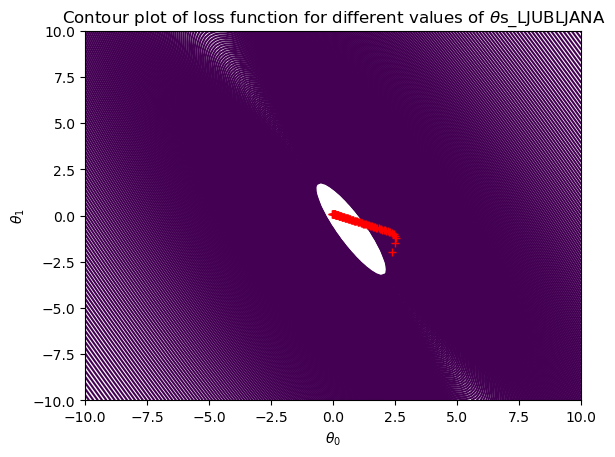

In [71]:
#show convergence

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,1000))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s_LJUBLJANA");
plt.plot(theta0_history2, theta1_history2, 'r+');

 - The gradient descent algorithm is converging towards a value of approximately **0.4127339 for the z-axis**

- Reaching a value close to zero for the gradient of the z-axis suggests that we are indeed converging towards the global minimum. In this case, achieving a gradient close to zero indicates that the algorithm has effectively found the lowest point in the cost function's landscape.